In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
import os
os.chdir('..')

In [5]:
import sklearn.utils as sk_utils
import numpy as np
import pandas as pd
import argparse
import json
import utils
from glob import glob

In [6]:
import sys
sys.path.insert(0,'../mimic3-benchmarks/')

In [7]:
import matplotlib.pyplot as plt
import plotly.express as px


In [8]:
RUN_ID = '2xdwyub7'
LISTFILE_ROOT = '/home/ashankar/mimic3_data/data/'
LISTFILE = 'test_listfile'
SET = 'test'

In [9]:
nevents_df = pd.read_csv(f'notebooks/{LISTFILE}_n_events.csv')
demog_df = pd.read_csv(f'mimic3-benchmarks/data/multitask/{SET}/demogfile.csv')

tables = ['CHARTEVENTS', 'LABEVENTS', 'OUTPUTEVENTS', 'INPUTEVENTS_*', 'PRESCRIPTIONS']
nevents_df['TOTAL'] = nevents_df[tables].sum(1)

In [10]:
demog_df

,filename,Icustay,Ethnicity,Gender,Age,Height,Weight,Length of Stay,Mortality,Diagnosis 4019,...,Diagnosis 570,Diagnosis 71590,Diagnosis 2869,Diagnosis 2763,Diagnosis 5770,Diagnosis V5865,Diagnosis 99662,Diagnosis 28860,Diagnosis 36201,Diagnosis 56210
0,60244_episode1_timeseries.csv,233547,4,1,69.854644,NaN,139.900000,0.5090,1,0,...,0,0,1,0,0,0,0,0,0,0
1,49485_episode1_timeseries.csv,251750,4,1,90.000000,160.0,86.000000,11.3531,1,1,...,0,0,0,0,0,0,0,0,0,0
2,42130_episode1_timeseries.csv,271350,4,2,63.228992,NaN,122.000000,2.1577,0,1,...,0,0,0,0,0,0,0,0,0,0
3,6468_episode1_timeseries.csv,206363,4,1,89.019119,NaN,NaN,3.7412,0,0,...,0,0,0,0,0,0,0,0,0,0
4,22331_episode1_timeseries.csv,257379,4,1,72.593522,NaN,NaN,1.2207,0,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6289,30139_episode2_timeseries.csv,250016,4,1,79.584998,168.0,68.600000,1.4328,0,0,...,0,0,0,0,0,0,0,0,0,0
6290,52234_episode1_timeseries.csv,208180,4,2,27.235215,NaN,86.500000,1.8886,0,0,...,0,0,0,0,0,0,0,0,0,0
6291,91384_episode1_timeseries.csv,206149,4,2,29.207666,NaN,61.869949,1.8932,0,0,...,0,0,0,0,0,0,0,0,0,0
6292,17621_episode1_timeseries.csv,220758,4,2,83.794177,NaN,85.199997,1.7702,0,0,...,0,0,0,0,0,0,0,0,0,0


In [11]:
train_nevents_df = pd.read_csv(f'notebooks/train_listfile_n_events.csv')

tables = ['CHARTEVENTS', 'LABEVENTS', 'OUTPUTEVENTS', 'INPUTEVENTS_*', 'PRESCRIPTIONS']
train_nevents_df['TOTAL'] = train_nevents_df[tables].sum(1)

In [12]:
from dataloader.labels import get_labels
labels = get_labels('cpu')

# Phenotyping

In [6]:
!ls wandb/*{RUN_ID}/{LISTFILE}_predictions/phenotyping*.csv

wandb/run-20201112_153556-2xdwyub7/test_listfile_predictions/phenotyping-epoch19.csv


In [10]:
class args:
    prediction = glob(f'wandb/*{RUN_ID}/{LISTFILE}_predictions/phenotyping*.csv')[-1]
    test_listfile = f'{LISTFILE_ROOT}/phenotyping/{LISTFILE}.csv'

In [11]:
pred_df = pd.read_csv(args.prediction, index_col=False, dtype={'period_length': np.float32})
test_df = pd.read_csv(args.test_listfile, index_col=False, dtype={'period_length': np.float32})

n_tasks = 25
labels_cols = ["label_{}".format(i) for i in range(1, n_tasks + 1)]
test_df.columns = list(test_df.columns[:2]) + labels_cols

df = test_df.merge(pred_df, left_on='stay', right_on='stay', how='left', suffixes=['_l', '_r'])
assert (df['pred_1'].isnull().sum() == 0)
assert (df['period_length_l'].equals(df['period_length_r']))
for i in range(1, n_tasks + 1):
    assert (df['label_{}_l'.format(i)] == df['label_{}_r'.format(i)]).all()

In [12]:
data = np.zeros((df.shape[0], 50))
for i in range(1, n_tasks + 1):
    data[:, i - 1] = df['pred_{}'.format(i)]
    data[:, 25 + i - 1] = df['label_{}_l'.format(i)]

In [13]:
kidney = pred_df.sort_values(['label_5', 'pred_5'], ascending=False)[['stay', 'label_5', 'pred_5']]

In [14]:
kidney

,stay,label_5,pred_5
1409,20656_episode2_timeseries.csv,1.0,0.981110
3225,40861_episode1_timeseries.csv,1.0,0.977770
1840,23657_episode14_timeseries.csv,1.0,0.977015
1842,23657_episode16_timeseries.csv,1.0,0.973230
1962,24465_episode3_timeseries.csv,1.0,0.972696
...,...,...,...
4443,6332_episode1_timeseries.csv,0.0,0.000038
2234,26331_episode1_timeseries.csv,0.0,0.000030
1970,24568_episode1_timeseries.csv,0.0,0.000023
1087,18406_episode1_timeseries.csv,0.0,0.000021


In [19]:
THRES = []
pred_df[[c > [int(c.split(_)[1])] for c in pred_df.columns if c.startswith('pred')]]

,pred_1,pred_2,pred_3,pred_4,pred_5,pred_6,pred_7,pred_8,pred_9,pred_10,...,pred_16,pred_17,pred_18,pred_19,pred_20,pred_21,pred_22,pred_23,pred_24,pred_25
0,0.905270,0.000477,0.005328,0.278623,0.608459,0.039076,0.109599,0.064847,0.407391,0.121163,...,0.032814,0.504644,0.522030,0.030692,0.025985,0.099088,0.444811,0.101180,0.347700,0.073770
1,0.220451,0.150025,0.014794,0.251856,0.001702,0.006084,0.120706,0.011194,0.030917,0.027492,...,0.043995,0.002901,0.662109,0.023706,0.003160,0.046373,0.217615,0.058384,0.469598,0.037064
2,0.009277,0.002239,0.158003,0.417076,0.008996,0.025938,0.252492,0.096281,0.172310,0.938031,...,0.000541,0.018514,0.001371,0.011537,0.002530,0.014765,0.004611,0.001285,0.002191,0.002009
3,0.913557,0.006146,0.037628,0.135778,0.161132,0.053238,0.102439,0.012186,0.094332,0.059585,...,0.549443,0.141508,0.755019,0.018757,0.005934,0.017625,0.054996,0.774130,0.826692,0.768943
4,0.030177,0.693788,0.039531,0.357894,0.021693,0.027377,0.115573,0.263387,0.086721,0.360044,...,0.011339,0.033174,0.002038,0.056754,0.011343,0.030057,0.031561,0.006602,0.008267,0.000793
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6276,0.913604,0.170517,0.135975,0.682046,0.427566,0.079824,0.257467,0.193846,0.440539,0.367755,...,0.034719,0.331484,0.056226,0.037038,0.030696,0.107917,0.163257,0.874343,0.587762,0.549995
6277,0.022856,0.097934,0.023749,0.290226,0.018652,0.007361,0.207525,0.010330,0.028730,0.230154,...,0.002319,0.019729,0.004068,0.037133,0.014400,0.016373,0.005911,0.001396,0.000726,0.000267
6278,0.025272,0.004666,0.976822,0.144174,0.002588,0.009538,0.150214,0.046434,0.197513,0.924562,...,0.002384,0.012048,0.016124,0.008677,0.001114,0.005060,0.017854,0.002050,0.048074,0.195353
6279,0.157776,0.038101,0.008464,0.344700,0.017728,0.086862,0.037852,0.060220,0.115895,0.162632,...,0.008679,0.026185,0.012295,0.155487,0.017751,0.039078,0.309626,0.070631,0.081635,0.023476


In [56]:
from sklearn.metrics import average_precision_score, precision_recall_fscore_support, multilabel_confusion_matrix

In [94]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


def print_confusion_matrix(confusion_matrix, axes, class_label, class_names, fontsize=14):

    df_cm = pd.DataFrame(
        confusion_matrix, index=class_names, columns=class_names,
    )

    try:
        heatmap = sns.heatmap(df_cm, annot=True, fmt="d", cbar=False, cmap='Greys', ax=axes, square=True)
    except ValueError:
        raise ValueError("Confusion matrix values must be integers.")
    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right', fontsize=fontsize)
    axes.set_xlabel('True label')
    axes.set_ylabel('Prediction')
    axes.set_title(' '.join(class_label.split(' ')[:2]) + "\n" + ' '.join(class_label.split(' ')[2:]))

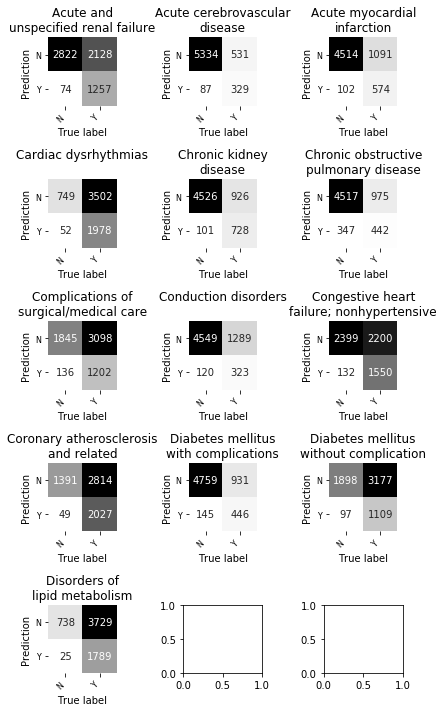

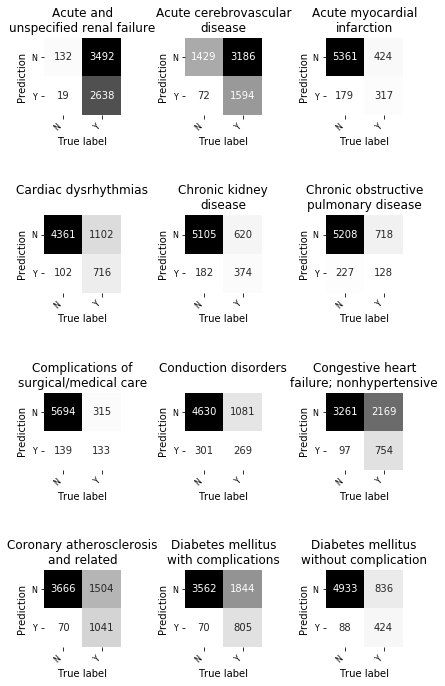

In [97]:
fig, ax = plt.subplots(5, 3, figsize=(6, 10))

for axes, cfs_matrix, label in zip(ax.flatten(), cm[:13], labels['phenotyping'].classes):
    print_confusion_matrix(cfs_matrix, axes=axes, class_label=label, class_names=['N', 'Y'], fontsize=8)

    
fig.tight_layout()
plt.savefig('notebooks/figures/phenotyping-cm-1.pdf')

fig, ax = plt.subplots(4, 3, figsize=(6, 10))
for axes, cfs_matrix, label in zip(ax.flatten(), cm[13:], labels['phenotyping'].classes):
    print_confusion_matrix(cfs_matrix, axes=axes, class_label=label, class_names=['N', 'Y'], fontsize=8)

    
fig.tight_layout()
plt.savefig('notebooks/figures/phenotyping-cm-2.pdf')


In [81]:
cm = multilabel_confusion_matrix(pred_df[[c for c in pred_df.columns if c.startswith('label')]].astype(int), pred_df[[c for c in pred_df.columns if c.startswith('pred')]].apply(lambda x: x > 0.1).astype(int), labels=np.arange(25))

In [15]:
kidney[kidney.stay.isin(ihm_stays)]

NameError: name 'ihm_stays' is not defined

In [16]:
ihm_stays = pred_df[pred_df['y_true'] == 1].sort_values('prediction').stay

KeyError: 'y_true'

In [17]:
ihm_stays.str.contains('89697').any()

NameError: name 'ihm_stays' is not defined

## Event density estimation

In [ ]:
train_df = pd.read_csv(f'{LISTFILE_ROOT}phenotyping/train_listfile.csv')

table = tables

sum_nevents_df = train_df.merge(train_nevents_df, on='stay', how='inner').sort_values('stay')
sum_nevents_df = sum_nevents_df[table + ['stay']]
df_events_dens = sum_nevents_df.groupby('stay').agg(['max', 'min', 'median', 'sum']).reset_index()
df_events_dens = train_df.merge(df_events_dens, left_on='stay', right_on='stay', how='inner').sort_values('stay')

In [ ]:
from itertools import product
X = np.array(df_events_dens[product(tables, ['max', 'min', 'median', 'sum'])])
X.shape

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler, Normalizer, KBinsDiscretizer
from sklearn.naive_bayes import MultinomialNB, ComplementNB
from sklearn.svm import LinearSVC, SVC
from sklearn.kernel_ridge import KernelRidge
from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import roc_auc_score

In [ ]:
from sklearn.pipeline import Pipeline

In [ ]:
pipeline = Pipeline([
    ('scaler', StandardScaler()), 
#     ('predictor', MultinomialNB())
#         ('scaler', KBinsDiscretizer(strategy='kmeans')),
#         ('predictor', OneVsRestClassifier(ComplementNB())),
        ('predictor', OneVsRestClassifier(LogisticRegression())),
#     ('predictor', LogisticRegression())
#     ('predictor', LogisticRegression())
    
])

In [ ]:
clf = pipeline.fit(X, np.array(df_events_dens.iloc[:, 2:27]))

In [ ]:
roc_auc_score(np.array(df_events_dens.iloc[:, 2:27]), clf.predict_proba(X))

In [ ]:
table = tables
    
sum_nevents_df = df.merge(nevents_df, on='stay', how='inner').sort_values('stay')
sum_nevents_df = sum_nevents_df[table + ['stay']]
df_events_dens = sum_nevents_df.groupby('stay').agg(['max', 'min', 'median', 'sum']).reset_index()
df_events_dens = df.merge(df_events_dens, left_on='stay', right_on='stay', how='inner').sort_values('stay')

In [ ]:
X = np.array(df_events_dens[product(tables, ['max', 'min', 'median', 'sum'])])
X.shape

In [ ]:
np.array(df_events_dens.iloc[:, 2:27])

In [ ]:
roc_auc_score(np.array(df_events_dens.iloc[:, 2:27]), clf.predict_proba(X))

# IHM

In [10]:
class args:
    prediction = glob(f'wandb/*{RUN_ID}/{LISTFILE}_predictions/in_hospital_mortality*.csv')[-1]
    test_listfile = f'{LISTFILE_ROOT}in-hospital-mortality/{LISTFILE}.csv'

In [11]:
glob(f'wandb/*{RUN_ID}/{LISTFILE}_predictions/in_hospital_mortality*.csv')[-1]

'wandb/run-20201112_153556-2xdwyub7/test_listfile_predictions/in_hospital_mortality-epoch19.csv'

In [12]:
test_df = pd.read_csv(args.test_listfile, index_col=False)
pred_df = pd.read_csv(args.prediction, index_col=False)

df = test_df.merge(pred_df, left_on='stay', right_on='stay', how='left', suffixes=['_l', '_r'])
assert (df['prediction'].isnull().sum() == 0)
assert (df['y_true_l'] == df['y_true_r']).all()

In [13]:
data = np.zeros((df.shape[0], 2))
data[:, 0] = np.array(df['prediction'])
data[:, 1] = np.array(df['y_true_l'])

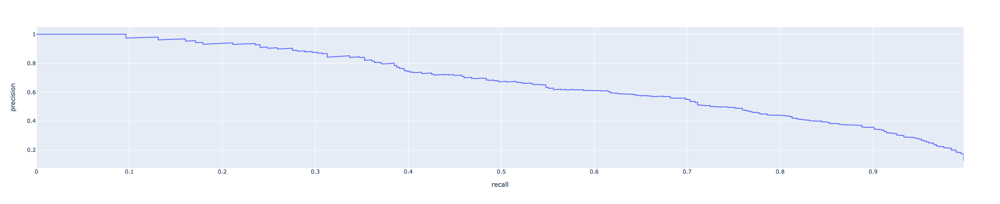

In [14]:
from sklearn.metrics import precision_recall_curve, confusion_matrix, precision_recall_fscore_support
precision, recall, thresholds = precision_recall_curve(data[:, 1], data[:, 0])
prt = pd.DataFrame(np.stack([recall[1:], precision[1:], thresholds], 1), columns=['recall', 'precision', 'thresholds'])
px.line(prt, x='recall', y='precision', hover_data=['thresholds'])

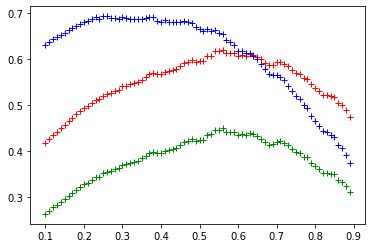

In [15]:
import sklearn

plt.figure()

for i in np.arange(0.1, 0.9, 0.01):
    CM = confusion_matrix(data[:, 1], data[:, 0] > i)

    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    plt.plot(i, sklearn.metrics.fbeta_score(data[:, 1], data[:, 0] > i, beta=1), marker='+', c='r')
    plt.plot(i, sklearn.metrics.fbeta_score(data[:, 1], data[:, 0] > i, beta=2), marker='+', c='b')
    
    plt.plot(i, (TP) / (TP + FP + FN), marker='+', c='g')

In [16]:
THRES = 0.15
display(precision_recall_fscore_support(data[:, 1], data[:, 0] > THRES, beta=2))

CM = confusion_matrix(data[:, 1], data[:, 0] > THRES)
TN = CM[0][0]
FN = CM[1][0]
TP = CM[1][1]
FP = CM[0][1]
(TP) / (TP + FP + FN)

(array([0.98708752, 0.30305677]),
 array([0.721174  , 0.92780749]),
 array([0.76224241, 0.65694813]),
 array([2862,  374]))

0.2960750853242321

In [17]:
THRES = 0.4
display(precision_recall_fscore_support(data[:, 1], data[:, 0] >  THRES, beta=1))
CM = confusion_matrix(data[:, 1], data[:, 0] > THRES)
TN = CM[0][0]
FN = CM[1][0]
TP = CM[1][1]
FP = CM[0][1]
(TP) / (TP + FP + FN)

(array([0.96890789, 0.44343891]),
 array([0.87106918, 0.78609626]),
 array([0.9173873 , 0.56702025]),
 array([2862,  374]))

0.39569313593539707

In [18]:
round(0.6125331, 3)

0.613

In [19]:
demog_df['Age_10Group'] = pd.cut(demog_df['Age'], 5)

In [20]:
from sklearn.metrics import average_precision_score

In [21]:
df.sort_values('stay')

,stay,y_true_l,prediction,y_true_r
0,10011_episode1_timeseries.csv,1,0.270060,1.0
1,10026_episode1_timeseries.csv,0,0.094336,0.0
2,10030_episode1_timeseries.csv,0,0.038295,0.0
3,10042_episode1_timeseries.csv,0,0.088966,0.0
4,10094_episode1_timeseries.csv,0,0.771742,0.0
...,...,...,...,...
3231,9970_episode1_timeseries.csv,0,0.278529,0.0
3232,9977_episode1_timeseries.csv,0,0.005508,0.0
3233,99863_episode1_timeseries.csv,0,0.224412,0.0
3234,99883_episode1_timeseries.csv,0,0.028455,0.0


In [22]:
demog_df

,filename,Icustay,Ethnicity,Gender,Age,Height,Weight,Length of Stay,Mortality,Diagnosis 4019,...,Diagnosis 71590,Diagnosis 2869,Diagnosis 2763,Diagnosis 5770,Diagnosis V5865,Diagnosis 99662,Diagnosis 28860,Diagnosis 36201,Diagnosis 56210,Age_10Group
0,60244_episode1_timeseries.csv,233547,4,1,69.854644,NaN,139.900000,0.5090,1,0,...,0,1,0,0,0,0,0,0,0,"(61.259, 75.63]"
1,49485_episode1_timeseries.csv,251750,4,1,90.000000,160.0,86.000000,11.3531,1,1,...,0,0,0,0,0,0,0,0,0,"(75.63, 90.0]"
2,42130_episode1_timeseries.csv,271350,4,2,63.228992,NaN,122.000000,2.1577,0,1,...,0,0,0,0,0,0,0,0,0,"(61.259, 75.63]"
3,6468_episode1_timeseries.csv,206363,4,1,89.019119,NaN,NaN,3.7412,0,0,...,0,0,0,0,0,0,0,0,0,"(75.63, 90.0]"
4,22331_episode1_timeseries.csv,257379,4,1,72.593522,NaN,NaN,1.2207,0,1,...,0,0,0,0,0,0,0,0,0,"(61.259, 75.63]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6289,30139_episode2_timeseries.csv,250016,4,1,79.584998,168.0,68.600000,1.4328,0,0,...,0,0,0,0,0,0,0,0,0,"(75.63, 90.0]"
6290,52234_episode1_timeseries.csv,208180,4,2,27.235215,NaN,86.500000,1.8886,0,0,...,0,0,0,0,0,0,0,0,0,"(18.076, 32.519]"
6291,91384_episode1_timeseries.csv,206149,4,2,29.207666,NaN,61.869949,1.8932,0,0,...,0,0,0,0,0,0,0,0,0,"(18.076, 32.519]"
6292,17621_episode1_timeseries.csv,220758,4,2,83.794177,NaN,85.199997,1.7702,0,0,...,0,0,0,0,0,0,0,0,0,"(75.63, 90.0]"


In [23]:
gender_age_df = df.merge(demog_df[['filename', 'Gender', 'Age_10Group']], left_on='stay', right_on='filename', how='inner')

female_prediction, male_prediction = gender_age_df[gender_age_df['Gender'] == 1], gender_age_df[gender_age_df['Gender'] == 2]
average_precision_score(female_prediction['y_true_l'], female_prediction['prediction']), average_precision_score(male_prediction['y_true_l'], male_prediction['prediction'])

(0.6702661342437437, 0.6823749949258392)

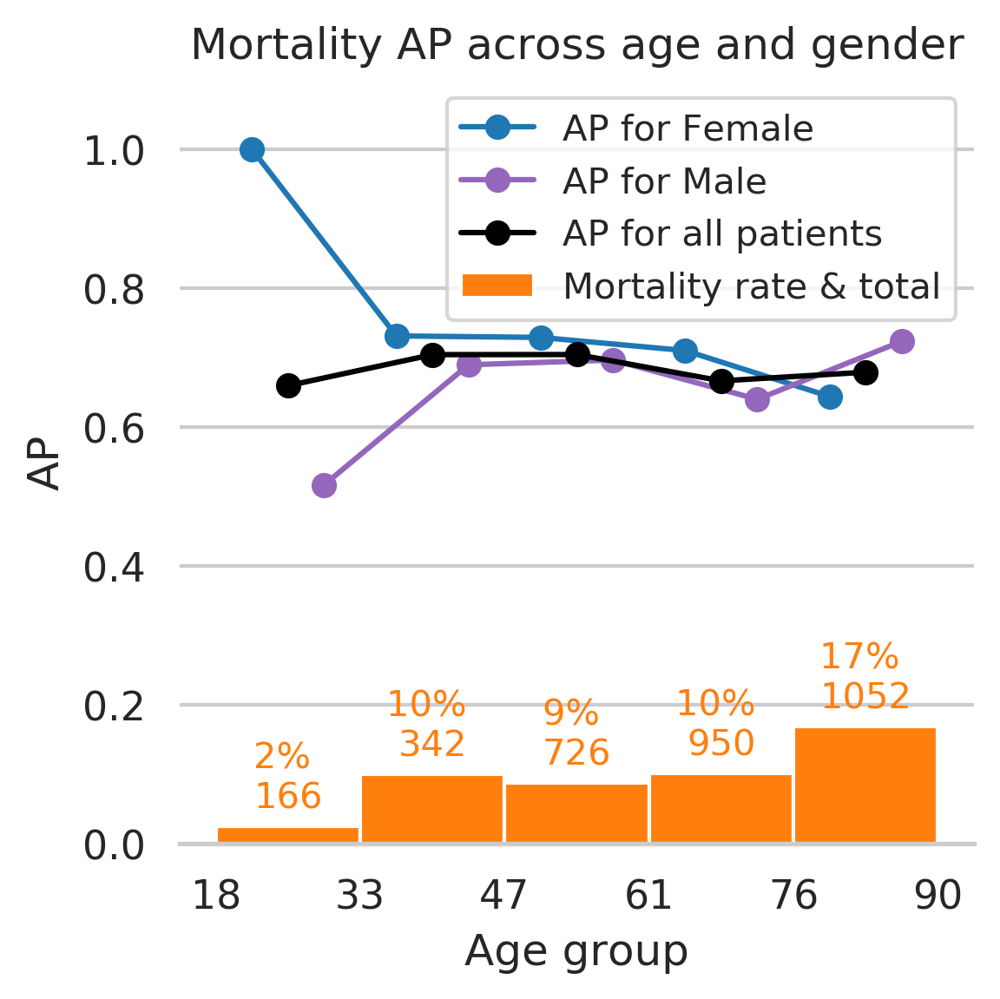

In [37]:
from sklearn.metrics import average_precision_score
from matplotlib.ticker import ScalarFormatter
import seaborn as sns

sns.set_theme(style="whitegrid")

fig, ax = plt.subplots(figsize=(4,4), dpi=300)
# ax2 = ax.twinx()
# ax2.set_ylabel('Number of samples')
# ax2.set_ylim((0, 650))
ax.grid(axis='x')
# ax2.grid(axis='y', linestyle='--')

plt.title('Mortality AP across age and gender')
# ax_right = ax.twinx()

total = np.zeros(5)
total_pos = np.zeros(5)
age_groups = sorted(demog_df['Age_10Group'].unique())
for j, g, c in zip([1, 2], ['Female', 'Male'], ['tab:blue', 'tab:purple']):
    scores = []
    counts = []
    pos = []
    for i, group in enumerate(age_groups):
        group_df = gender_age_df[(gender_age_df['Gender']==j) & (gender_age_df['Age_10Group']==group)]
        scores.append(average_precision_score(group_df['y_true_l'], 
                                              group_df['prediction']))
        counts.append(group_df['y_true_l'].count())
        pos.append(group_df['y_true_l'].sum())
        
        total[i] += counts[-1]
        total_pos[i] += pos[-1]
        
        
    ax.plot(np.arange(len(scores)) + .25+(0.5*(j - 1)), scores, label=f'AP for {g}', marker='o', c=c)
    
# ax2.bar(np.arange(len(total)) + 0.5, total, label=f'Number of patients', width=1)

all_scores = []
for i, group in enumerate(age_groups):
    all_patients = gender_age_df[gender_age_df['Age_10Group'] == group]
    all_scores.append(average_precision_score(all_patients['y_true_l'], all_patients['prediction']))
ax.plot(np.arange(len(all_scores)) + .5, all_scores, label=f'AP for all patients', marker='o', c='black')

rect1 = ax.bar(np.arange(len(counts))+0.5, total_pos/total, color='tab:orange', label=f'Mortality rate & total', width=1)

counts = np.array(counts).astype(float)

def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect, ann, i in zip(rects, np.array(total_pos)/np.array(total)*100, range(len(rects))):
        height = rect.get_height()
        an = ax.annotate(
#             f'{pos[i]}/\n',
            f'{ann:.0f}% \n{total[i].round(0).astype(int)}',
            fontsize=10,
            xy=(rect.get_x() + rect.get_width() / 2, height),
            xytext=(0, 3),  # 3 points vertical offset
            color='tab:orange',
            textcoords="offset points",
            ha='center', va='bottom')

autolabel(rect1)

ax.legend(loc='upper right', fontsize=10)

ax.set_ylim((0,1.1))

plt.xticks(range(len(scores) + 1), [f'{i.left:.0f}' for i in age_groups] + [f'{age_groups[-1].right:.0f}']);
ax.set_ylabel('AP')
ax.set_xlabel('Age group')
plt.tight_layout()
sns.despine(left=True)
plt.savefig('notebooks/figures/AP_age_gender.pdf')

In [ ]:
train_df = pd.read_csv(f'{LISTFILE_ROOT}in-hospital-mortality/train_listfile.csv')

table = tables

sum_nevents_df = train_df.merge(train_nevents_df, on='stay', how='inner').sort_values('stay')
sum_nevents_df = sum_nevents_df[sum_nevents_df['period_length'] < 48]
sum_nevents_df = sum_nevents_df[table + ['stay']].sort_values('stay')
df_events_dens = sum_nevents_df.groupby('stay').agg(['max', 'min', 'median', 'sum']).reset_index()
# sum_nevents_df['ACC_Group'], bins = pd.cut(sum_nevents_df[table], 10, retbins=True)
df_events_dens = train_df.merge(df_events_dens, left_on='stay', right_on='stay', how='inner').sort_values('stay')

In [ ]:
# X = sum_nevents_df.groupby('stay').agg(list)[tables].apply(lambda x: sum(x, []), 1)
# X = np.array(X.tolist())

from itertools import product
X = np.array(df_events_dens[product(tables, ['max', 'min', 'median', 'sum'])])
X.shape

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler, Normalizer, KBinsDiscretizer
from sklearn.naive_bayes import MultinomialNB, ComplementNB
from sklearn.svm import LinearSVC, SVC
from sklearn.kernel_ridge import KernelRidge

In [ ]:
from sklearn.pipeline import Pipeline

In [ ]:
pipeline = Pipeline([

#     ('predictor', MultinomialNB())
#         ('scaler', KBinsDiscretizer(strategy='kmeans')),
    ('scaler', StandardScaler()), 
#         ('predictor', ComplementNB())
#     ('predictor', SVC())
    ('predictor', LogisticRegression())
    
])

In [25]:
clf = pipeline.fit(X, df_events_dens['y_true'])

NameError: name 'pipeline' is not defined

In [26]:
from sklearn.metrics import average_precision_score
average_precision_score(df_events_dens['y_true'], clf.predict_proba(X)[:,1])

NameError: name 'df_events_dens' is not defined

In [ ]:
table = tables

sum_nevents_df = df.merge(nevents_df, on='stay', how='inner').sort_values('stay')
sum_nevents_df = sum_nevents_df[sum_nevents_df['period_length'] < 48]
sum_nevents_df = sum_nevents_df[table + ['stay']]
df_events_dens = sum_nevents_df.groupby('stay').agg(['max', 'min', 'median', 'sum']).reset_index()
# sum_nevents_df['ACC_Group'], bins = pd.cut(sum_nevents_df[table], 10, retbins=True)
df_events_dens = df.merge(df_events_dens, left_on='stay', right_on='stay', how='inner').sort_values('stay')

In [ ]:
X = np.array(df_events_dens[product(tables, ['max', 'min', 'median', 'sum'])])


In [ ]:
average_precision_score(df_events_dens['y_true_l'], clf.predict_proba(X)[:,1])

In [ ]:
average_precision_score(df_events_dens['y_true_l'], df_events_dens['prediction'])

In [ ]:
table = "TOTAL"

sum_nevents_df = df.merge(nevents_df[nevents_df['period_length'] < 48], on='stay', how='inner').sort_values('stay')
sum_nevents_df = sum_nevents_df[[table] + ['stay']]
sum_nevents_df = sum_nevents_df.groupby('stay').sum().reset_index()
sum_nevents_df['ACC_Group'], bins = pd.cut(sum_nevents_df[table], 10, retbins=True)
df_events_dens = df.merge(sum_nevents_df, on='stay', how='inner').sort_values('stay')

In [ ]:
bins

In [ ]:
from sklearn.metrics import average_precision_score
from matplotlib.ticker import ScalarFormatter
import seaborn as sns

sns.set_theme(style="whitegrid")

fig, ax = plt.subplots(figsize=(4,4), dpi=300)

plt.title('In-hospital-mortality AP across #events')
# ax_right = ax.twinx()

l_groups = sorted(df_events_dens['ACC_Group'].unique())
l_groups = l_groups[:-2]

scores = []
random = []
counts = []
pos = []
for i in l_groups:
    group = df_events_dens[(df_events_dens['ACC_Group']==i)]
    scores.append(average_precision_score(group['y_true_l'], 
                                          group['prediction']))
    random.append(average_precision_score(group['y_true_l'], np.ones_like(group['prediction'])*(group['y_true_l'].sum()/group['y_true_l'].count()+0.0001)))
    counts.append(group['y_true_l'].count())
    pos.append(group['y_true_l'].sum())
    
ax.plot(np.arange(len(scores))+0.5, scores, label=f'AP', marker='o')

# ax.plot(np.arange(len(random))+0.5, random, label=f'random AP / ratio of positive examples')

# ax.bar(np.arange(len(counts)), counts/sum(counts), label=f'#patients', width=0.5)
# rect1 = ax.bar(np.arange(len(counts))+0.5, pos/sum(counts), width=1)
rect1 = ax.bar(np.arange(len(counts))+0.5, np.array(pos)/np.array(counts), color='tab:orange', label=f'Mortality rate & total', width=1)

def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect, ann, i in zip(rects, np.array(pos)/np.array(counts)*100, range(len(rects))):
        height = rect.get_height()
        an = ax.annotate(
#             f'{pos[i]}/\n',
            f'{ann:.0f}% \n{counts[i]}',
            fontsize=10,
            xy=(rect.get_x() + rect.get_width() / 2, height),
            xytext=(0, 3),  # 3 points vertical offset
            color='tab:orange',
            textcoords="offset points",
            ha='center', va='bottom')

autolabel(rect1)

ax.xaxis.set_major_formatter(ScalarFormatter())
ax.ticklabel_format(axis='x', style='sci', useMathText=True)

plt.legend(loc='upper left')
ax.set_ylim((0,1.1))
plt.grid(True, axis='y')
plt.grid(False, axis='x')
plt.xticks(range(0, len(scores) + 1, 2), [f'{(np.abs(i.left)).round(-2):.0f}' for i in l_groups[::2]])
plt.xlabel('Number of events in 48h')
plt.ylabel('AP')
sns.despine(left=True)
plt.tight_layout()
plt.savefig('notebooks/figures/AP_numevents_ihm.pdf')

# LOS

In [13]:
!ls /home/ashankar/mimic3_data/data/

decompensation	       length-of-stay  phenotyping
in-hospital-mortality  multitask       root


In [14]:
class args:
    prediction = glob(f'wandb/*{RUN_ID}/{LISTFILE}_predictions/length_of_stay_regression*.csv')[-1]
    cl_prediction = glob(f'wandb/*{RUN_ID}/{LISTFILE}_predictions/length_of_stay_classification*.csv')[-1]
    test_listfile = f'{LISTFILE_ROOT}/length-of-stay/{LISTFILE}.csv'

In [15]:
pred_df = pd.read_csv(args.prediction, index_col=False, dtype={'period_length': np.float32,
                                                               'y_true': np.float32})
test_df = pd.read_csv(args.test_listfile, index_col=False, dtype={'period_length': np.float32,
                                                               'y_true': np.float32})
cl_pred_df = pd.read_csv(args.cl_prediction, index_col=False, dtype={'period_length': np.float32,
                                                               'y_true': np.float32})

test_df = test_df[test_df['period_length'] < 100] 

df = test_df.merge(pred_df, left_on=['stay', 'period_length'], right_on=['stay', 'period_length'],
                   how='left', suffixes=['_l', '_r'])
# assert (df['prediction'].isnull().sum() == 0)
# assert (df['y_true_l'] == df['y_true_r']).all()

In [16]:
cl_pred_df

,stay,period_length,prediction,y_true
0,10000_episode1_timeseries.csv,5.0,1.0,1.0
1,10000_episode1_timeseries.csv,6.0,1.0,1.0
2,10000_episode1_timeseries.csv,7.0,1.0,1.0
3,10000_episode1_timeseries.csv,8.0,1.0,0.0
4,10000_episode1_timeseries.csv,9.0,1.0,0.0
...,...,...,...,...
525899,99983_episode1_timeseries.csv,20.0,0.0,0.0
525900,99983_episode1_timeseries.csv,21.0,0.0,0.0
525901,99983_episode1_timeseries.csv,22.0,0.0,0.0
525902,99983_episode1_timeseries.csv,23.0,0.0,0.0


In [17]:
df = test_df.merge(pred_df, left_on=['stay', 'period_length'], right_on=['stay', 'period_length'],
              how='left', suffixes=['_l', '_r'])
df = df.dropna()
df = df.merge(cl_pred_df, left_on=['stay', 'period_length'], right_on=['stay', 'period_length'],
                   how='left', suffixes=['_reg', '_cl'])
df['prediction_reg'] = df['prediction_reg'].clip(lower=0)

In [18]:
df

,stay,period_length,y_true_l,prediction_reg,y_true_r,prediction_cl,y_true
0,10000_episode1_timeseries.csv,5.0,26.8312,22.620934,26.8312,1.0,1.0
1,10000_episode1_timeseries.csv,6.0,25.8312,23.676426,25.8312,1.0,1.0
2,10000_episode1_timeseries.csv,7.0,24.8312,22.930355,24.8312,1.0,1.0
3,10000_episode1_timeseries.csv,8.0,23.8312,23.110600,23.8312,1.0,0.0
4,10000_episode1_timeseries.csv,9.0,22.8312,21.533245,22.8312,1.0,0.0
...,...,...,...,...,...,...,...
323792,99983_episode1_timeseries.csv,20.0,4.9576,9.394985,4.9576,0.0,0.0
323793,99983_episode1_timeseries.csv,21.0,3.9576,7.853671,3.9576,0.0,0.0
323794,99983_episode1_timeseries.csv,22.0,2.9576,7.288061,2.9576,0.0,0.0
323795,99983_episode1_timeseries.csv,23.0,1.9576,6.782027,1.9576,0.0,0.0


In [19]:
x = np.stack([pd.cut(df['y_true_l'], bins=np.array([-1] + list(range(1, 9)) + [14, 100]) * 24, labels=False, include_lowest=True), 
              pd.cut(df['prediction_reg'], bins=np.array([-1] + list(range(1, 9)) + [14, 100]) * 24, labels=False, include_lowest=True),
              df['prediction_cl']]).clip(0)

(array([4.5297e+04, 5.5834e+04, 4.4795e+04, 3.7080e+04, 2.4942e+04,
        1.6709e+04, 1.2712e+04, 9.9420e+03, 7.7360e+03, 6.6190e+03,
        5.8460e+03, 5.3050e+03, 4.7890e+03, 4.3270e+03, 4.0040e+03,
        3.6960e+03, 3.4620e+03, 3.3720e+03, 3.2020e+03, 3.2130e+03,
        3.1070e+03, 3.3750e+03, 3.7690e+03, 4.6180e+03, 4.5140e+03,
        1.4880e+03, 4.4000e+01, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00]),
 array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.,
        110., 120., 130., 140., 150., 160., 170., 180., 190., 200., 210.,
        220., 230., 240., 250., 260., 270., 280., 290., 300., 310., 320.,
        330., 340., 350., 360., 370., 380., 390., 400., 410., 420., 430.,
        440., 450., 46

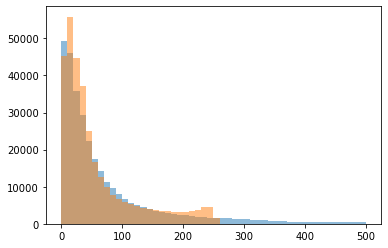

In [20]:
plt.hist(df['y_true_l'], range=(0, 500), alpha=0.5, bins=50)
plt.hist(df['prediction_reg'], range=(0, 500), alpha=0.5, bins=50, )

In [21]:
sns.barplot(x = tips_df.day, y = tips_df.total_bill, hue = tips_df.sex)

NameError: name 'sns' is not defined

In [24]:
pd.cut(df['y_true_l'], bins=np.array([-1] + list(range(1, 9)) + [14, 100]) * 24, labels=False, include_lowest=True).min()

0

In [25]:
labels.keys()

dict_keys(['decompensation', 'in_hospital_mortality', 'length_of_stay_classification', 'length_of_stay_regression', 'phenotyping'])

In [26]:
x[2].max()

9.0

In [27]:
from sklearn.metrics import confusion_matrix

In [70]:
def human_format(num):
    magnitude = 0
    if num >= 1000:
        return f'{str(np.round(num, -3))[:-3]}K'
    else:
        return str(num)

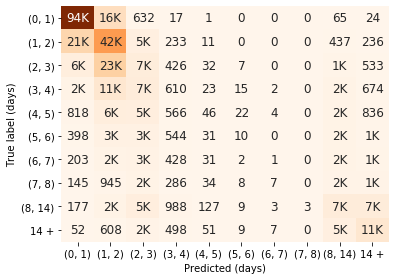

In [82]:
fig, ax = plt.subplots(1, 1, figsize=(5.6, 4),)

cm = confusion_matrix(x[0], x[2])
cm_annot = np.array(pd.DataFrame(cm).applymap(lambda x: human_format(x)))
ax, _ = utils.plot_confusion_matrix(cm, labels['length_of_stay_classification'], ax, square=False, annot=cm_annot, fmt='s', annot_kws=dict(fontsize=12))
ax.set_xlabel('Predicted (days)')
ax.set_ylabel('True label (days)')
plt.savefig('notebooks/figures/los_cl.pdf')

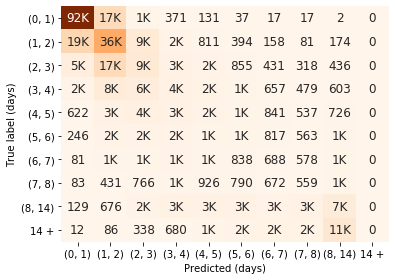

In [81]:
fig, ax = plt.subplots(1, 1, figsize=(5.6, 4),)

cm = confusion_matrix(x[0], x[1])
cm_annot = np.array(pd.DataFrame(cm).applymap(lambda x: human_format(x)))
ax, _ = utils.plot_confusion_matrix(cm, labels['length_of_stay_classification'], ax, annot=cm_annot,square=False, fmt='s', annot_kws=dict(fontsize=12))
ax.set_xlabel('Predicted (days)')
ax.set_ylabel('True label (days)')
plt.savefig('notebooks/figures/los_reg.pdf')

# Decompensation

In [42]:
class args:
    prediction = glob(f'wandb/*{RUN_ID}/{LISTFILE}_predictions/decompensation*.csv')[-1]
    test_listfile = f'{LISTFILE_ROOT}/decompensation/{LISTFILE}.csv'

In [43]:
pred_df = pd.read_csv(args.prediction, index_col=False, dtype={'period_length': np.float32})
test_df = pd.read_csv(args.test_listfile, index_col=False, dtype={'period_length': np.float32})

df = test_df.merge(pred_df, left_on=['stay', 'period_length'], right_on=['stay', 'period_length'],
                   how='left', suffixes=['_l', '_r'])
pd.set_option("display.max_rows", 20)
# print(df[df['prediction'].isnull()].sort_values(['stay', 'period_length']))
# print(df[~df['prediction'].isnull()].sort_values(['stay', 'period_length']))
# assert (df['prediction'].isnull().sum() == 0)
# assert (df['y_true_l'] == df['y_true_r']).all()

In [44]:
df = df.dropna(subset=['prediction'])

In [45]:
# df = df.groupby('stay').agg({'prediction': 'max', 'y_true_l': 'max'})

In [46]:
data = np.zeros((df.shape[0], 2),dtype=float)
data[:, 0] = np.array(df['prediction'])
data[:, 1] = np.array(df['y_true_l'])

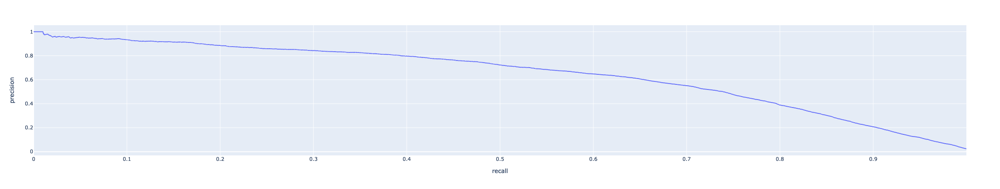

In [47]:
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import plot_precision_recall_curve
import matplotlib.pyplot as plt

from sklearn.metrics import precision_recall_curve, confusion_matrix, precision_recall_fscore_support
precision, recall, thresholds = precision_recall_curve(data[:, 1], data[:, 0])
prt = pd.DataFrame(np.stack([recall[1:], precision[1:], thresholds], 1), columns=['recall', 'precision', 'thresholds'])
px.line(prt, x='recall', y='precision', hover_data=['thresholds'])

In [48]:
nevents_df.set_index(['stay', 'period_length']).groupby('stay').agg({'TOTAL': 'cumsum'}).reset_index()

,stay,period_length,TOTAL
0,10000_episode1_timeseries.csv,0,27
1,10000_episode1_timeseries.csv,1,53
2,10000_episode1_timeseries.csv,2,82
3,10000_episode1_timeseries.csv,3,144
4,10000_episode1_timeseries.csv,4,178
...,...,...,...
557456,99983_episode1_timeseries.csv,20,759
557457,99983_episode1_timeseries.csv,21,769
557458,99983_episode1_timeseries.csv,22,779
557459,99983_episode1_timeseries.csv,23,801


In [52]:
from sklearn.preprocessing import KBinsDiscretizer

In [90]:
def quantile_bins(values):
    hist = KBinsDiscretizer(7, encode='ordinal')
    inds = hist.fit_transform(values[:,None])
    bins = hist.bin_edges_
    return inds, bins[0]

In [91]:
def uniform_bins(values):
    return pd.cut(values, 7, retbins=True, duplicates='raise')

In [92]:
sum_nevents_df = nevents_df.set_index(['stay', 'period_length']).groupby('stay').agg({'TOTAL': 'cumsum'}).reset_index()
# sum_nevents_df['TOTAL'] /= sum_nevents_df['period_length'] + 1
sum_nevents_df['ACC_Group'], bins = uniform_bins(sum_nevents_df['TOTAL'])
sum_nevents_df['ACC_Group'], bins = quantile_bins(sum_nevents_df['TOTAL'])

In [93]:
df_events_dens = df.merge(sum_nevents_df, on=['stay', 'period_length'], how='inner')
df_events_dens = df_events_dens.dropna(subset=['prediction', 'y_true_l'])

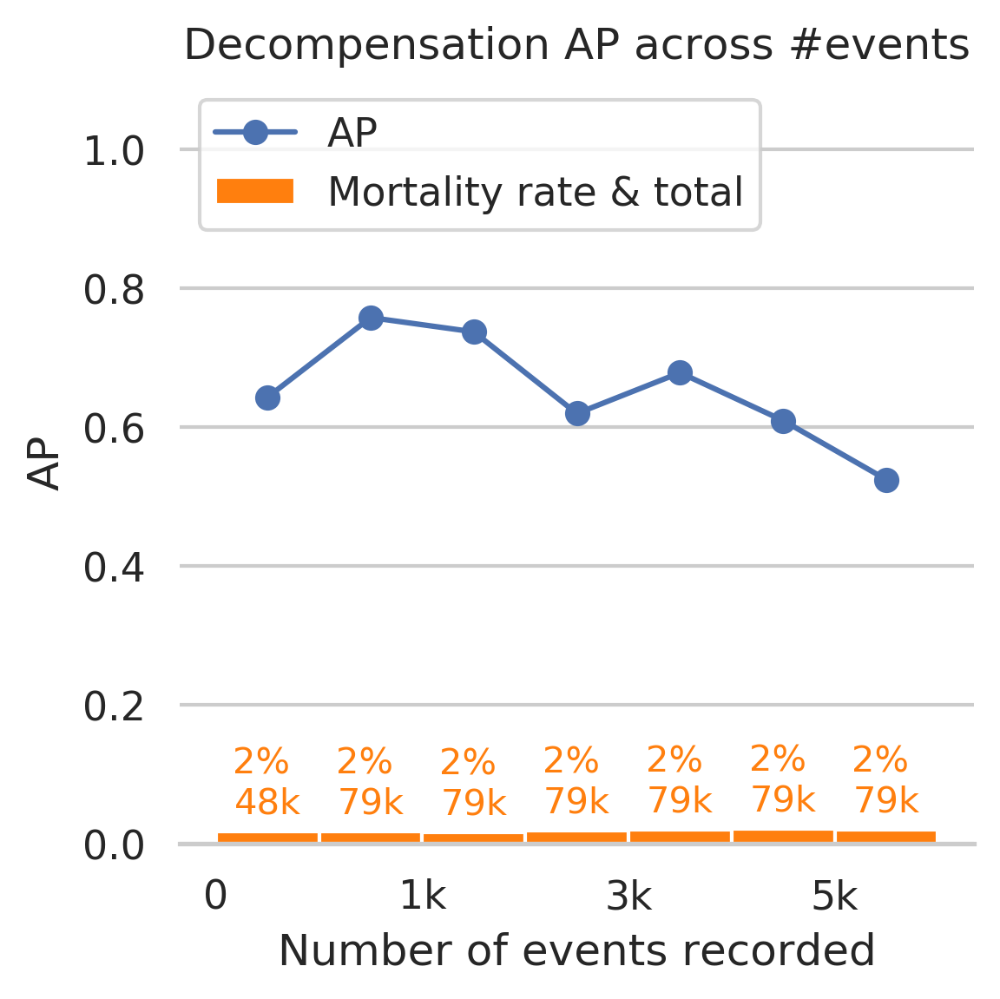

In [95]:
from sklearn.metrics import average_precision_score
import seaborn as sns

sns.set_theme(style="whitegrid")

fig, ax = plt.subplots(figsize=(4,4), dpi=300)
plt.grid(axis='y')

plt.title('Decompensation AP across #events')
# ax_right = ax.twinx()

l_groups = sorted(df_events_dens['ACC_Group'].unique())
l_groups = l_groups

scores = []
random = []
counts = []
pos = []
for i in l_groups:
    group = df_events_dens[(df_events_dens['ACC_Group']==i)]
    scores.append(average_precision_score(group['y_true_l'], 
                                          group['prediction']))
    random.append(average_precision_score(group['y_true_l'], np.ones_like(group['prediction'])*(group['y_true_l'].sum()/group['y_true_l'].count())))
    counts.append(group['y_true_l'].count())
    pos.append(group['y_true_l'].sum())

ax.plot(np.arange(len(scores))+0.5, scores, label=f'AP', marker='o')

# ax.plot(np.arange(len(random))+0.5, random, label=f'random AP / ratio of positive examples')

# ax.bar(np.arange(len(counts)), counts/sum(counts), label=f'#patients', width=0.5)
# rect1 = ax.bar(np.arange(len(counts))+0.5, pos/sum(counts), width=1)
rect1 = ax.bar(np.arange(len(counts))+0.5, np.array(pos)/np.array(counts), color='tab:orange', label=f'Mortality rate & total', width=1)

def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect, ann, i in zip(rects, np.array(pos)/np.array(counts)*100, range(len(rects))):
        height = rect.get_height()
        an = ax.annotate(
#             f'{pos[i]}/\n',
            f'{ann:.0f}% \n{counts[i]}' if counts[i] < 1000 else f'{ann:.0f}% \n{str(counts[i].round(-3))[:-3]}k',
            fontsize=10,
            xy=(rect.get_x() + rect.get_width() / 2, height),
            xytext=(0, 3),  # 3 points vertical offset
            color='tab:orange',
            textcoords="offset points",
            ha='center', va='bottom')


autolabel(rect1)

plt.legend(loc='upper left')
ax.set_ylim((0,1.1))
plt.grid(axis='y')
plt.grid(False, axis='x')
# plt.xticks(range(0, len(scores) + 1, 2), [0] + [f'{i.left:.0f}' for i in l_groups[2::2]] + [f'{l_groups[-1].right:.0f}'])
plt.xticks(range(0, len(scores) + 1, 2), [0] + [f'{str(int((np.abs(i))))}k' for i in l_groups[1::2]])
plt.xlabel('Number of events recorded')
plt.ylabel('AP')
plt.tight_layout()
sns.despine(left=True)
plt.savefig('notebooks/figures/AP_nevents_decomp.pdf')

In [96]:
pl_df = nevents_df.copy()
# pl_df['PL_Group'], bins = pd.cut(pl_df['period_length'], np.array(list(range(9)) + [14, 100]) * 24, right=False, retbins=True)
pl_df['PL_Group'], bins = quantile_bins(pl_df['period_length'])
df_pl = df.merge(pl_df, on=['stay', 'period_length'], how='inner')
df_pl.dropna(subset=['prediction'])
df_pl

,stay,period_length,y_true_l,prediction,y_true_r,CHARTEVENTS,LABEVENTS,OUTPUTEVENTS,INPUTEVENTS_*,PRESCRIPTIONS,TOTAL,PL_Group
0,10000_episode1_timeseries.csv,5.0,0,0.027383,0.0,30,0,0,1,0,31,0.0
1,10000_episode1_timeseries.csv,6.0,0,0.027822,0.0,29,0,0,1,0,30,0.0
2,10000_episode1_timeseries.csv,7.0,0,0.028122,0.0,23,0,1,1,0,25,0.0
3,10000_episode1_timeseries.csv,8.0,0,0.031588,0.0,89,0,0,0,0,89,0.0
4,10000_episode1_timeseries.csv,9.0,0,0.030673,0.0,23,0,0,1,0,24,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
523195,99983_episode1_timeseries.csv,20.0,0,0.000818,0.0,105,0,0,2,0,107,1.0
523196,99983_episode1_timeseries.csv,21.0,0,0.000865,0.0,9,0,0,1,0,10,1.0
523197,99983_episode1_timeseries.csv,22.0,0,0.000905,0.0,10,0,0,0,0,10,1.0
523198,99983_episode1_timeseries.csv,23.0,0,0.000926,0.0,22,0,0,0,0,22,1.0


In [97]:
average_precision_score(df_pl['y_true_l'], df_pl['prediction'])

0.6492725838102429

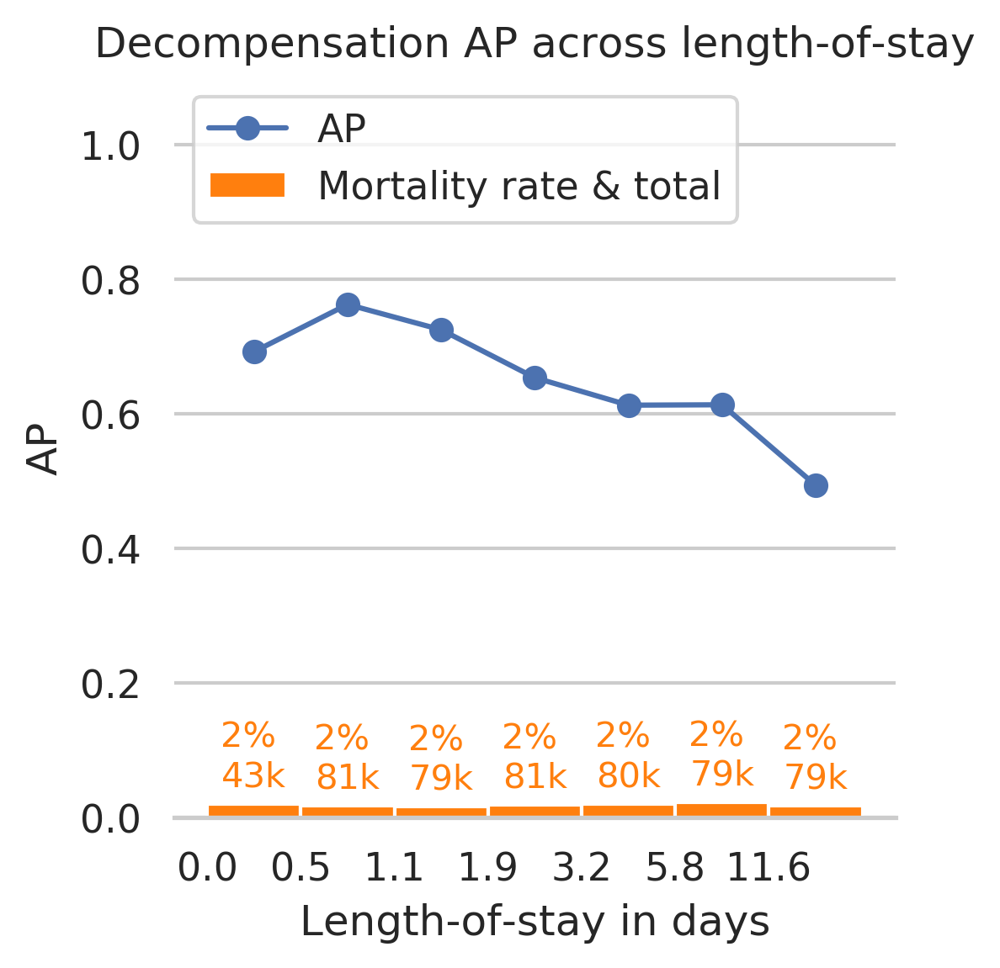

In [105]:
from sklearn.metrics import average_precision_score
import seaborn as sns

sns.set_theme(style="whitegrid")

fig, ax = plt.subplots(figsize=(4,4), dpi=300)
plt.grid(True, axis='y')
plt.grid(False, axis='x')

plt.title('Decompensation AP across length-of-stay')
# ax_right = ax.twinx()

l_groups = sorted(df_pl['PL_Group'].unique())
l_groups = l_groups

scores = []
random = []
counts = []
pos = []
for i in l_groups:
    group = df_pl[(df_pl['PL_Group']==i)]
    scores.append(average_precision_score(group['y_true_l'], 
                                          group['prediction']))
    random.append(average_precision_score(group['y_true_l'], np.ones_like(group['prediction'])*(group['y_true_l'].sum()/group['y_true_l'].count())))
    counts.append(group['y_true_l'].count())
    pos.append(group['y_true_l'].sum())

ax.plot(np.arange(len(scores))+0.5, scores, label=f'AP', marker='o')

# ax.plot(np.arange(len(random))+0.5, random, label=f'random AP / ratio of positive examples')

# ax.bar(np.arange(len(counts)), counts/sum(counts), label=f'#patients', width=0.5)
# rect1 = ax.bar(np.arange(len(counts))+0.5, pos/sum(counts), width=1)
rect1 = ax.bar(np.arange(len(counts))+0.5, np.array(pos)/np.array(counts), color='tab:orange', label=f'Mortality rate & total', width=1)

def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect, ann, i in zip(rects, np.array(pos)/np.array(counts)*100, range(len(rects))):
        height = rect.get_height()
        an = ax.annotate(
#             f'{pos[i]}/\n',
            f'{ann:.0f}% \n{counts[i]}' if counts[i] < 1000 else f'{ann:.0f}% \n{str(counts[i].round(-3))[:-3]}k',
            fontsize=10,
            xy=(rect.get_x() + rect.get_width() / 2, height),
            xytext=(0, 3),  # 3 points vertical offset
            color='tab:orange',
            textcoords="offset points",
            ha='center', va='bottom')

autolabel(rect1)

plt.legend(loc='upper left')
ax.set_ylim((0,1.1))
plt.xticks(range(0, len(scores) + 1), list((bins[:-1] / 24).round(1)))
# ax.set_xlim((-0.2, 9.2))
plt.xlabel('Length-of-stay in days')
plt.ylabel('AP')
plt.tight_layout()
sns.despine(left=True)
plt.savefig('notebooks/figures/AP_pl_decomp.pdf')

In [106]:
list((bins[:-1] / 24).round().astype(int))

[0, 0, 1, 2, 3, 6, 12]

In [107]:
l_groups

[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0]

In [124]:
from sklearn.metrics import confusion_matrix
recall80_ind = np.where(recall > 0.7)[0][-1]
print(recall[recall80_ind], precision[recall80_ind])

0.7000929464009088 0.5502435064935065


(<Figure size 432x432 with 1 Axes>,
 array([[507976,   5541],
        [  2905,   6778]]))

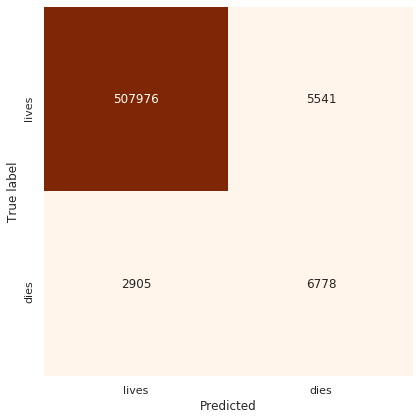

In [125]:
utils.plot_confusion_matrix(confusion_matrix(df['y_true_l'], df['prediction'] > thresholds[recall80_ind]), 
                      labels['decompensation'])

In [126]:
from utils import plot_confusion_matrix

In [127]:
from sklearn.metrics import classification_report
classification_report(df['y_true_l'], df['prediction'])

ValueError: Classification metrics can't handle a mix of binary and continuous targets

In [ ]:
flatten_decomp = df.groupby('stay').agg({'prediction':'max', 'y_true_l':'max'})
flatten_decomp['prediction']

from sklearn.metrics import f1_score
f1_score(flatten_decomp['y_true_l'], flatten_decomp['prediction'] > thresholds[recall80_ind])

In [ ]:
thresholds[recall80_ind]

In [128]:
average_precision_score(flatten_decomp['y_true_l'], flatten_decomp['prediction'] > thresholds[recall80_ind])

0.6697275532170146

In [61]:
def plot_decompensation(df, n_pat, time):
    import seaborn as sns
    sns.set_style('darkgrid')
    
    df = df.sort_values(['stay', 'period_length'])
    dying_patients = df[df.groupby(['stay'])['y_true_l'].transform('sum') > 0].groupby('stay').agg(lambda x: list(x))
    undying_patients = df[df.groupby(['stay'])['y_true_l'].transform('sum') == 0].groupby('stay').agg(lambda x: list(x))
    
    fig, axes = plt.subplots(1, 2, figsize=(5.6, 3.5))
    death = np.zeros((n_pat, time))
    labels = np.zeros((n_pat,time))
    for i, (_, (pat, l)) in enumerate(dying_patients[['prediction', 'y_true_l']].iterrows()):
        if len(pat) == 0: continue
        if i == n_pat: break
        l = l[-time:]
        pat = pat[-time:]
#         if 0 in l:
#             if l.index(1) > 76:
#                 labels[i, l.index(1)] = 1
        death[i, -len(pat):] = pat# - 2 * np.array(l)
#         death[i, -len(pat):] = (np.array(l) * 2 - 1) * pat # - 2 * np.array(l)
        
    death[:, time-24:] *= -1
    
    print(death)
    axes[0].set_title('Deceased patients')
    sns.heatmap(death, vmax=1, vmin=-1, cmap='bwr', ax=axes[0], cbar=False, rasterized=True)
#     axes[0].imshow(death, vmax=1, vmin=-1, cmap='bwr')
    # plt.scatter(np.where(labels == 1)[1], np.where(labels == 1)[0], color='r')
    axes[0].set_ylim((0,n_pat))
    
    death = np.zeros((n_pat, time))
    for i, pat in enumerate(undying_patients['prediction']):
        if len(pat) == 0: continue
        if i == n_pat: break
        pat = pat[-time:]
        death[i, -len(pat):] = pat

    axes[1].set_title('Living patients')
    sns.heatmap(death, vmax=1, vmin=-1, cmap='bwr', ax=axes[1], cbar=False, rasterized=True)

    axes[0].set_ylabel('Patients')
    axes[0].set_yticks([])
    axes[1].set_ylim((0, n_pat))
    
    axes[0].set_xticks(np.arange(time, 0, -24))
    axes[0].set_xticklabels(np.arange(5))
    axes[0].set_xlabel('Remaining length-of-stay (in days)')
    axes[0].set_xlim((0, time))
    
    axes[1].set_xticks(np.arange(time, 0, -24))
    axes[1].set_xticklabels(np.arange(5))
    axes[1].set_yticks([])
    axes[1].set_xlabel('')
    axes[1].set_xlim((0, time))
    plt.tight_layout(0.1)
    
    plt.savefig('notebooks/figures/deceased-living.pdf')

### Plot decompensation over time

[[ 0.048002  0.037571  0.060037 ... -0.961747 -0.963247 -0.957794]
 [ 0.        0.        0.       ... -0.998692 -0.998936 -0.999185]
 [ 0.        0.        0.       ... -0.984286 -0.984121 -0.98011 ]
 ...
 [ 0.        0.        0.       ... -0.998766 -0.998823 -0.998818]
 [ 0.262715  0.39136   0.358096 ... -0.998778 -0.99877  -0.998922]
 [ 0.        0.        0.       ... -0.994677 -0.999138 -0.998672]]


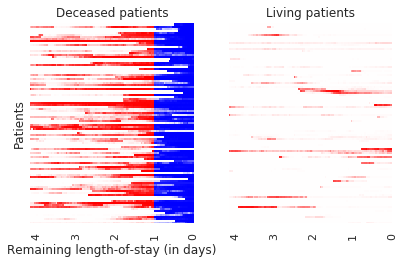

In [62]:
plot_decompensation(df, 100, 100)

In [49]:
CV_best = [2.995, 2.998, 2.958, 2.986, 2.895]